In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Installations

In [4]:
!pip install numpy opencv-python matplotlib
!pip install waymo-open-dataset-tf-2-11-0


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.0/4.0 MB 9.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 17.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 177.2/177.2 kB 19.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.8/11.8 MB 32.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.9/15.9 MB 44.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 54.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.1/12.1 MB 57.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.2/3.2 MB 81.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.2/15.2 MB 74.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 35.2/35.2 MB 13.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.2/13.2 MB 80.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 56.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [1]:
!pip install open3d

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 399.7/399.7 MB 2.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.5/7.5 MB 48.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.4/139.4 kB 14.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 28.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 49.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 51.0 MB/s eta 0:00:00
  Attempting uninstall: widgetsnbextension
    Found existing installation: widgetsnbextension 3.6.6
    Uninstalling widgetsnbextension-3.6.6:
      Successfully uninstalled widgetsnbextension-3.6.6
  Attempting uninstall: pillow
    Found existing installation: Pillow 9.2.0
    Uninstalling Pillow-9.2.0:
      Successfully uninstalled Pillow-9.2.0
  Attempting uninstall: ipywidgets
    Found existing installation: ipywidgets 7.7.1
    Uninstalling ipywidgets-7.7.1:
      Successfully uninstalled ipywidgets-7.7.1

## Libraries

In [1]:
# Libraries
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
from waymo_open_dataset import dataset_pb2 as open_dataset
import open3d as o3d
from mpl_toolkits.mplot3d import Axes3D
from waymo_open_dataset.utils import range_image_utils, transform_utils, frame_utils
import os

## File Paths

In [2]:
# File paths
tfrecord_file='/content/drive/MyDrive/Colab Notebooks/Object_Detection/Waymo_mini/waymo_format/training/segment-10023947602400723454_1120_000_1140_000_with_camera_labels.tfrecord'

## Unpacking tfrecord

In [3]:
dataset = tf.data.TFRecordDataset(tfrecord_file, compression_type='')
for data in dataset:
    frame = open_dataset.Frame()
    frame.ParseFromString(bytearray(data.numpy()))
    break

print(frame.context)

name: "10023947602400723454_1120_000_1140_000"
camera_calibrations {
  name: FRONT
  intrinsic: 2060.1425931120934
  intrinsic: 2060.1425931120934
  intrinsic: 975.5965057143899
  intrinsic: 630.853334844486
  intrinsic: 0.04141289654300018
  intrinsic: -0.33489740041263666
  intrinsic: 0.0005022866894809016
  intrinsic: -0.0009337226533304631
  intrinsic: 0.0
  extrinsic {
    transform: 0.9999790376291948
    transform: 0.0045643569339703614
    transform: -0.004592488211072773
    transform: 1.5393679168564702
    transform: -0.004561049760530192
    transform: 0.9999893316554864
    transform: 0.0007303425877435168
    transform: -0.023691101834458727
    transform: 0.004595772761080904
    transform: -0.0007093807107760264
    transform: 0.9999891877674156
    transform: 2.116014704116658
    transform: 0.0
    transform: 0.0
    transform: 0.0
    transform: 1.0
  }
  width: 1920
  height: 1280
  rolling_shutter_direction: LEFT_TO_RIGHT
}
camera_calibrations {
  name: FRONT_LEFT


## Displaying Images

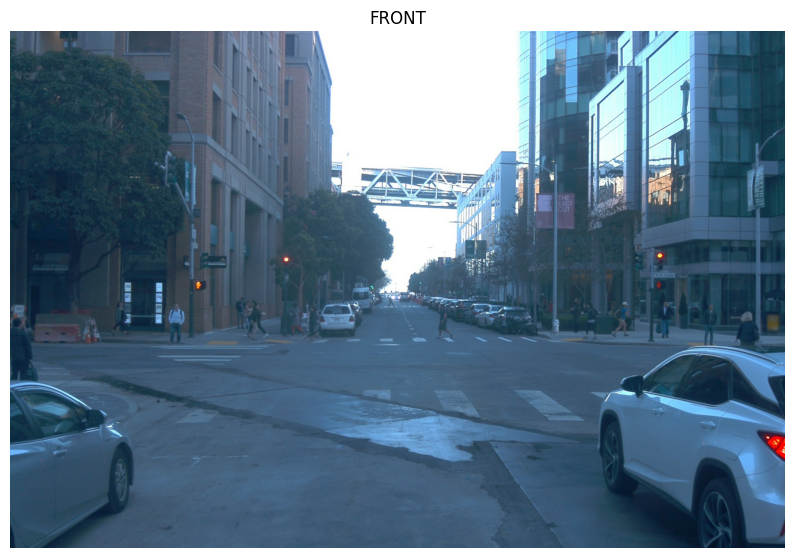

image size :  (1280, 1920, 3)


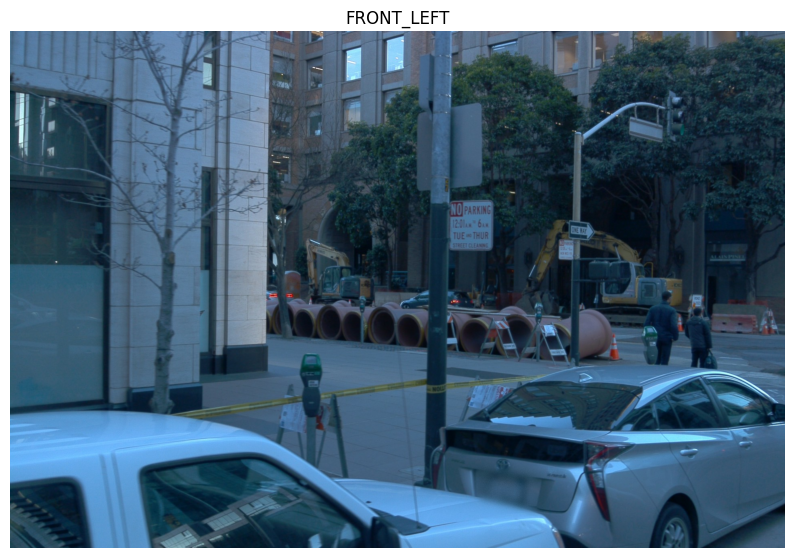

image size :  (1280, 1920, 3)


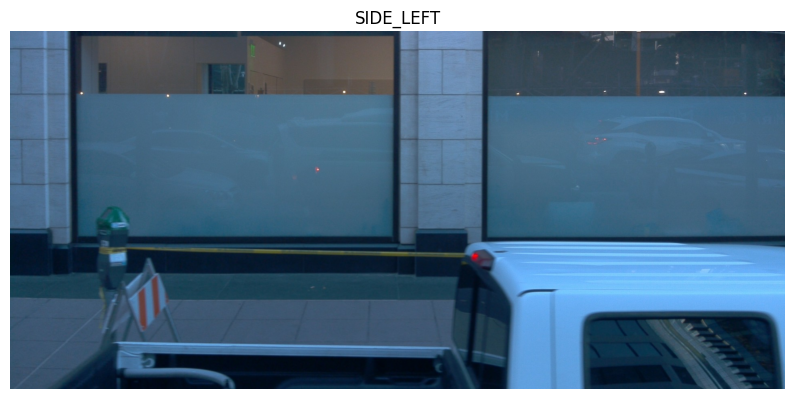

image size :  (886, 1920, 3)


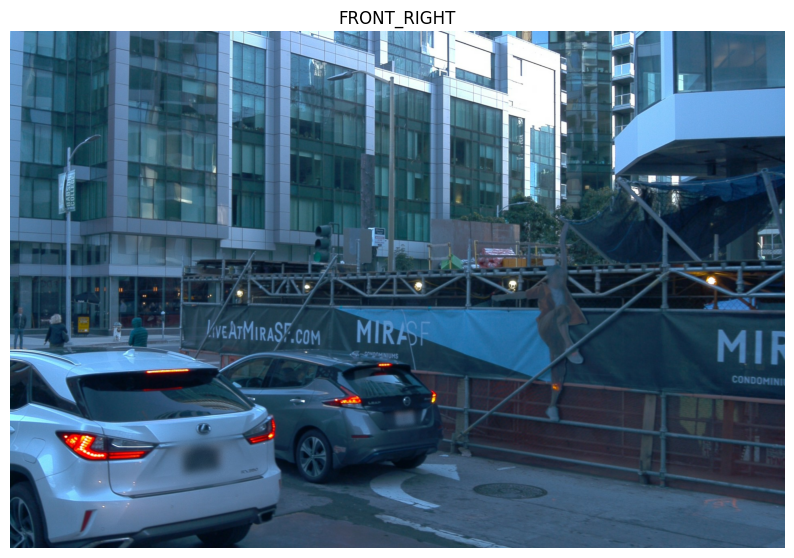

image size :  (1280, 1920, 3)


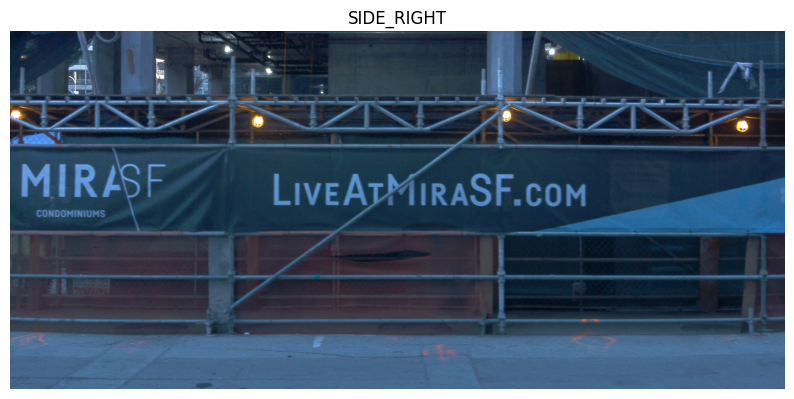

image size :  (886, 1920, 3)


In [4]:
def show_camera_image(camera_image, cmap=None):
    """Show a camera image without labels."""

    # Create a new figure for each image
    plt.figure(figsize=(10, 8))

    # Decode the JPEG image
    image = tf.image.decode_jpeg(camera_image.image)

    # Show the camera image
    plt.imshow(image, cmap=cmap)
    plt.title(open_dataset.CameraName.Name.Name(camera_image.name))
    plt.grid(False)
    plt.axis('off')
    plt.show()
    print("image size : ", image.shape)

# Assuming `frame` is the frame object containing the images
for image in frame.images:
    show_camera_image(image)

In [5]:
(range_images, camera_projections,
 _, range_image_top_pose) = frame_utils.parse_range_image_and_camera_projection(
    frame)

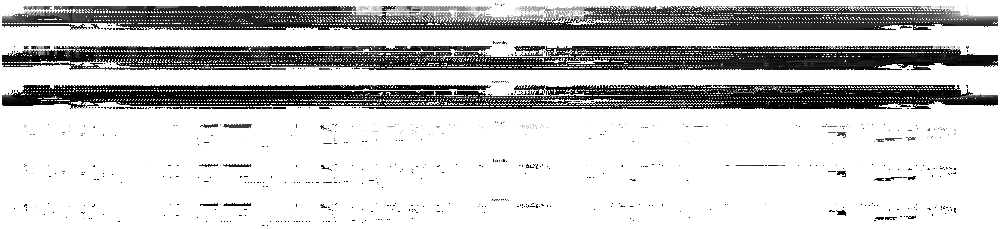

In [6]:
plt.figure(figsize=(64, 20))
def plot_range_image_helper(data, name, layout, vmin = 0, vmax=1, cmap='gray'):
  """Plots range image.

  Args:
    data: range image data
    name: the image title
    layout: plt layout
    vmin: minimum value of the passed data
    vmax: maximum value of the passed data
    cmap: color map
  """
  plt.subplot(*layout)
  plt.imshow(data, cmap=cmap, vmin=vmin, vmax=vmax)
  plt.title(name)
  plt.grid(False)
  plt.axis('off')

def get_range_image(laser_name, return_index):
  """Returns range image given a laser name and its return index."""
  return range_images[laser_name][return_index]

def show_range_image(range_image, layout_index_start = 1):
  """Shows range image.

  Args:
    range_image: the range image data from a given lidar of type MatrixFloat.
    layout_index_start: layout offset
  """
  range_image_tensor = tf.convert_to_tensor(range_image.data)
  range_image_tensor = tf.reshape(range_image_tensor, range_image.shape.dims)
  lidar_image_mask = tf.greater_equal(range_image_tensor, 0)
  range_image_tensor = tf.where(lidar_image_mask, range_image_tensor,
                                tf.ones_like(range_image_tensor) * 1e10)
  range_image_range = range_image_tensor[...,0]
  range_image_intensity = range_image_tensor[...,1]
  range_image_elongation = range_image_tensor[...,2]
  plot_range_image_helper(range_image_range.numpy(), 'range',
                   [8, 1, layout_index_start], vmax=75, cmap='gray')
  plot_range_image_helper(range_image_intensity.numpy(), 'intensity',
                   [8, 1, layout_index_start + 1], vmax=1.5, cmap='gray')
  plot_range_image_helper(range_image_elongation.numpy(), 'elongation',
                   [8, 1, layout_index_start + 2], vmax=1.5, cmap='gray')
frame.lasers.sort(key=lambda laser: laser.name)
show_range_image(get_range_image(open_dataset.LaserName.TOP, 0), 1)
show_range_image(get_range_image(open_dataset.LaserName.TOP, 1), 4)

In [7]:
points, cp_points = frame_utils.convert_range_image_to_point_cloud(
    frame,
    range_images,
    camera_projections,
    range_image_top_pose)
points_ri2, cp_points_ri2 = frame_utils.convert_range_image_to_point_cloud(
    frame,
    range_images,
    camera_projections,
    range_image_top_pose,
    ri_index=1)

# 3d points in vehicle frame.
points_all = np.concatenate(points, axis=0)
points_all_ri2 = np.concatenate(points_ri2, axis=0)
# camera projection corresponding to each point.
cp_points_all = np.concatenate(cp_points, axis=0)
cp_points_all_ri2 = np.concatenate(cp_points_ri2, axis=0)

In [8]:
print(points_all.shape)
print(cp_points_all.shape)
print(points_all[0:2])
for i in range(5):
  print(points[i].shape)
  print(cp_points[i].shape)

print(points_all_ri2.shape)
print(cp_points_all_ri2.shape)
print(points_all_ri2[0:2])
for i in range(5):
  print(points_ri2[i].shape)
  print(cp_points_ri2[i].shape)

(167802, 3)
(167802, 6)
[[-60.114258    4.7851562   4.4089966]
 [-29.783203    4.3623047   3.3137207]]
(149796, 3)
(149796, 6)
(4048, 3)
(4048, 6)
(4780, 3)
(4780, 6)
(4488, 3)
(4488, 6)
(4690, 3)
(4690, 6)
(14905, 3)
(14905, 6)
[[-59.5791      8.541992    4.396454 ]
 [-59.16797     8.77832     4.3824463]]
(14489, 3)
(14489, 6)
(72, 3)
(72, 6)
(86, 3)
(86, 6)
(221, 3)
(221, 6)
(37, 3)
(37, 6)


## 3D Point Cloud


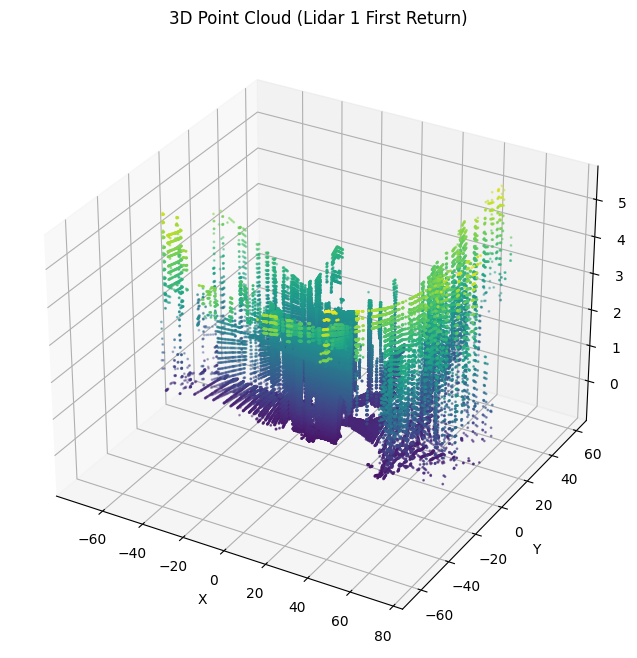

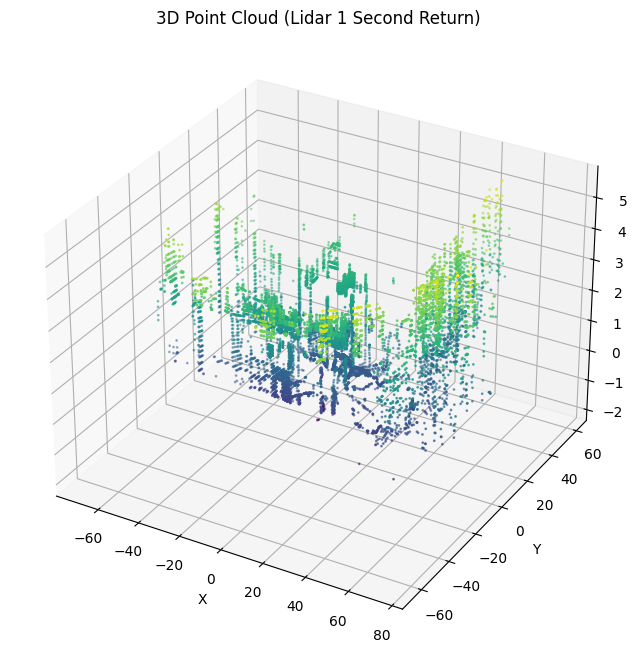

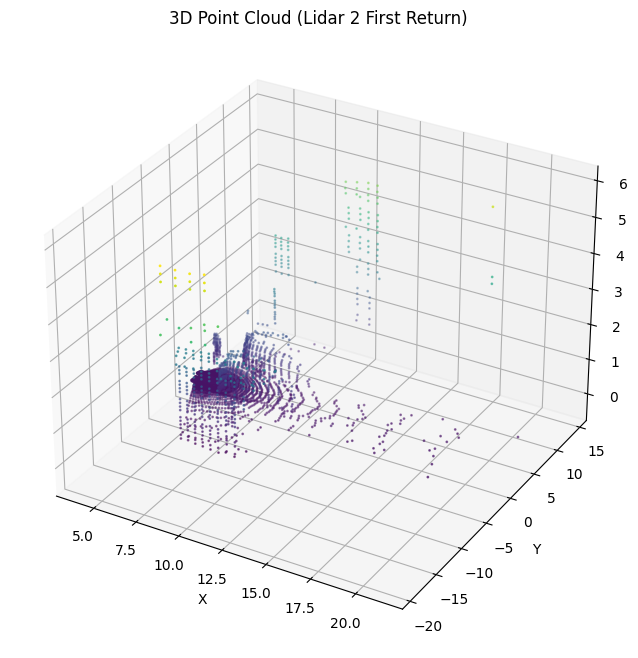

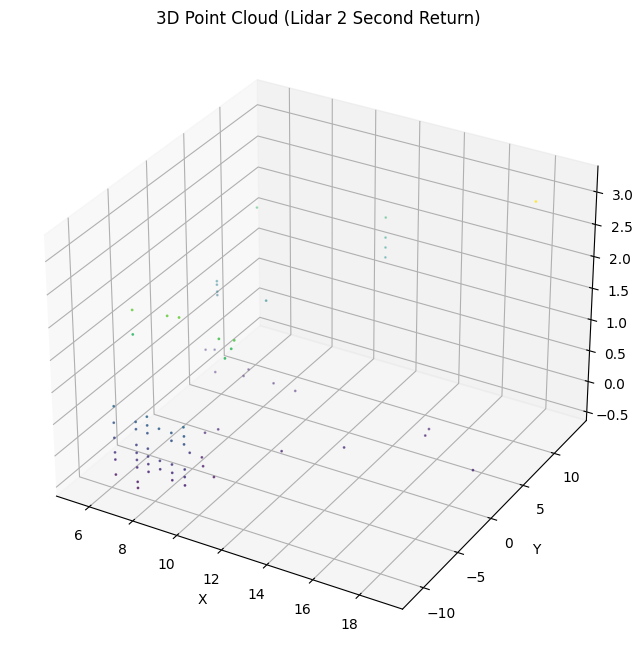

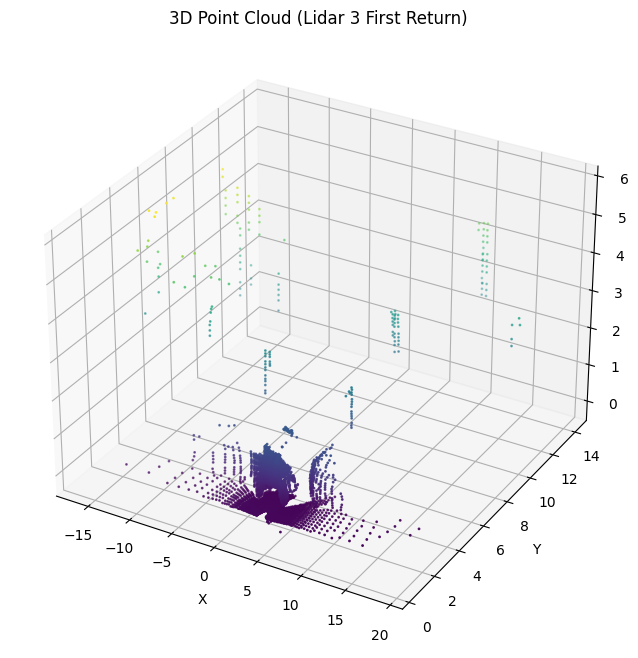

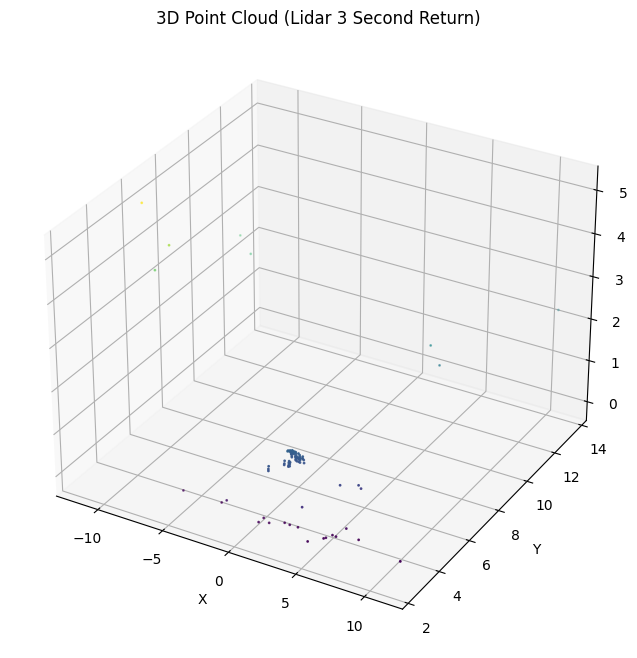

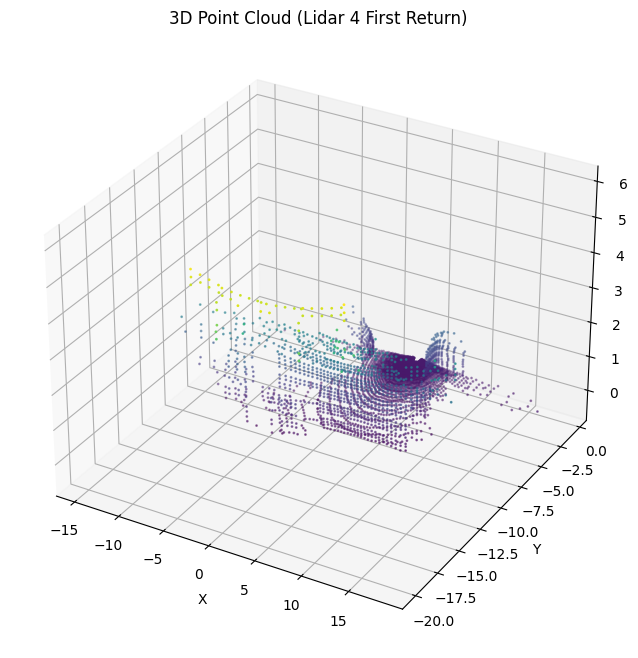

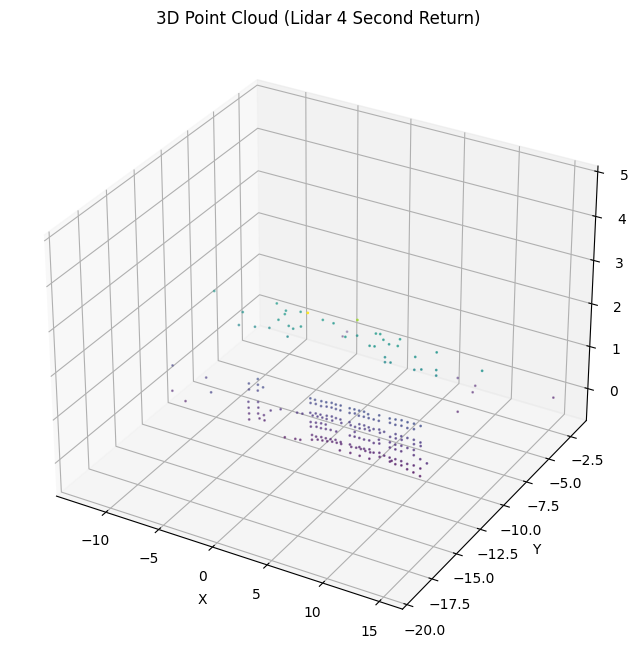

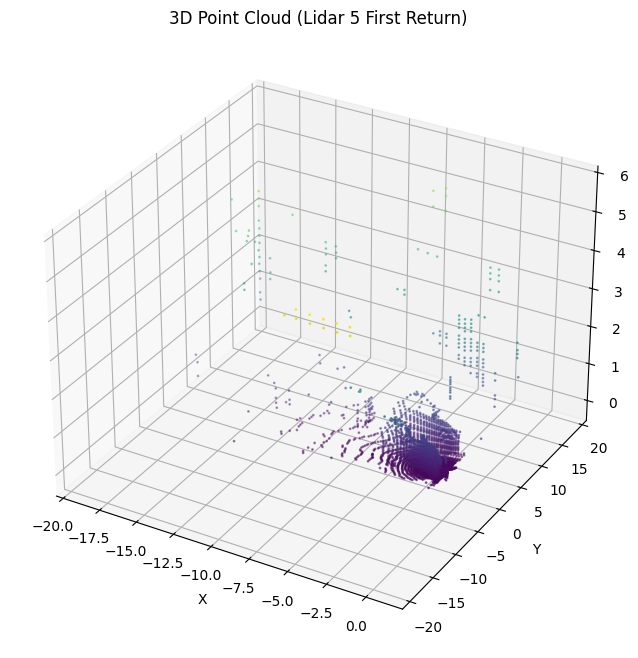

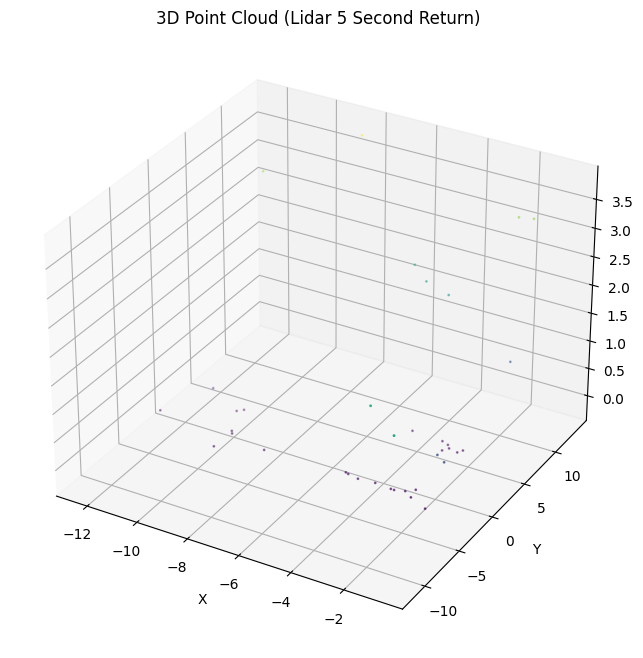

In [9]:
# Function to show and save the 3D point cloud
def show_and_save_point_cloud(points, title, filename):
    fig = plt.figure(figsize=(10, 8))
    ax = fig.add_subplot(111, projection='3d')
    ax.scatter(points[:, 0], points[:, 1], points[:, 2], s=1, c=points[:, 2], cmap='viridis')
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Z')
    plt.title(title)
    plt.show()
    fig.savefig(filename)

# Directory to save the point cloud images
output_dir = '/content/drive/MyDrive/Colab Notebooks/Object_Detection/Waymo_mini/waymo_format/point cloud'

# Create directory if it does not exist
os.makedirs(output_dir, exist_ok=True)

# Show and save point clouds for all lidars
for i in range(5):
    show_and_save_point_cloud(points[i], f'3D Point Cloud (Lidar {i+1} First Return)', os.path.join(output_dir, f'point_cloud_lidar_{i+1}_first_return.png'))
    show_and_save_point_cloud(points_ri2[i], f'3D Point Cloud (Lidar {i+1} Second Return)', os.path.join(output_dir, f'point_cloud_lidar_{i+1}_second_return.png'))

In [10]:
def rgba(r):
  """Generates a color based on range.

  Args:
    r: the range value of a given point.
  Returns:
    The color for a given range
  """
  c = plt.get_cmap('jet')((r % 20.0) / 20.0)
  c = list(c)
  c[-1] = 0.5  # alpha
  return c

def plot_image(camera_image):
  """Plot a cmaera image."""
  plt.figure(figsize=(20, 12))
  plt.imshow(tf.image.decode_jpeg(camera_image.image))
  plt.grid("off")

def plot_points_on_image(projected_points, camera_image, rgba_func,
                         point_size=5.0):
  """Plots points on a camera image.

  Args:
    projected_points: [N, 3] numpy array. The inner dims are
      [camera_x, camera_y, range].
    camera_image: jpeg encoded camera image.
    rgba_func: a function that generates a color from a range value.
    point_size: the point size.

  """
  plot_image(camera_image)

  xs = []
  ys = []
  colors = []

  for point in projected_points:
    xs.append(point[0])  # width, col
    ys.append(point[1])  # height, row
    colors.append(rgba_func(point[2]))

  plt.scatter(xs, ys, c=colors, s=point_size, edgecolors="none")

In [33]:
!pip install opencv-python

##Projecting lidar points on images

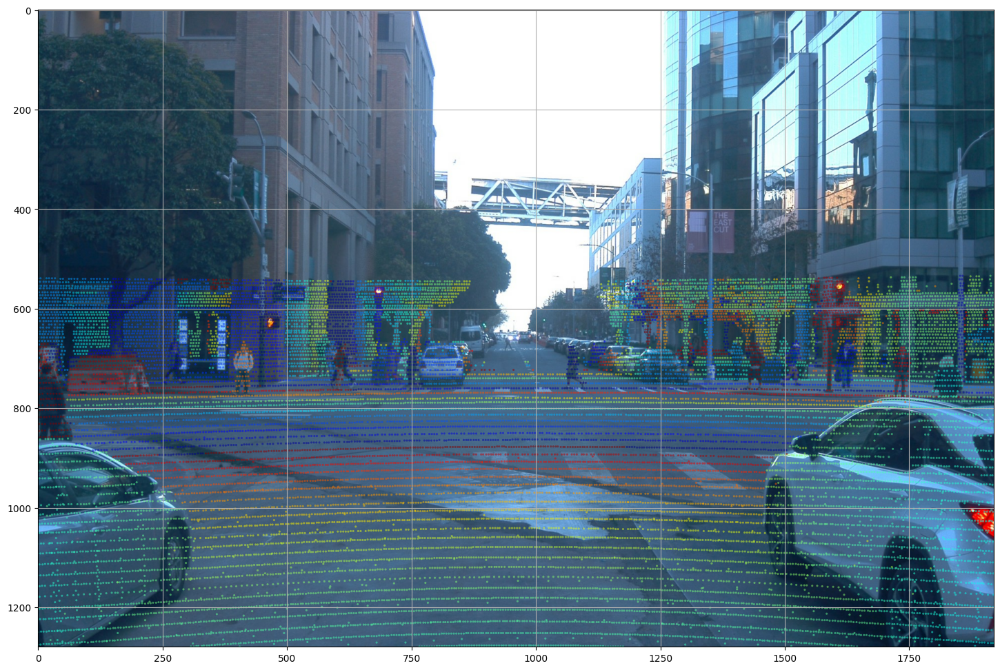

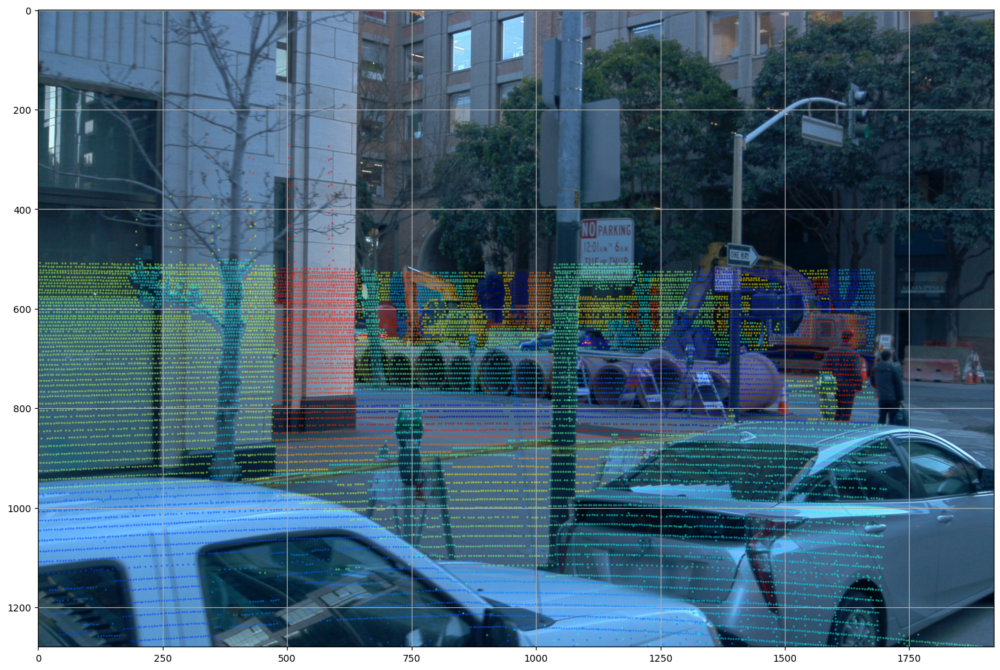

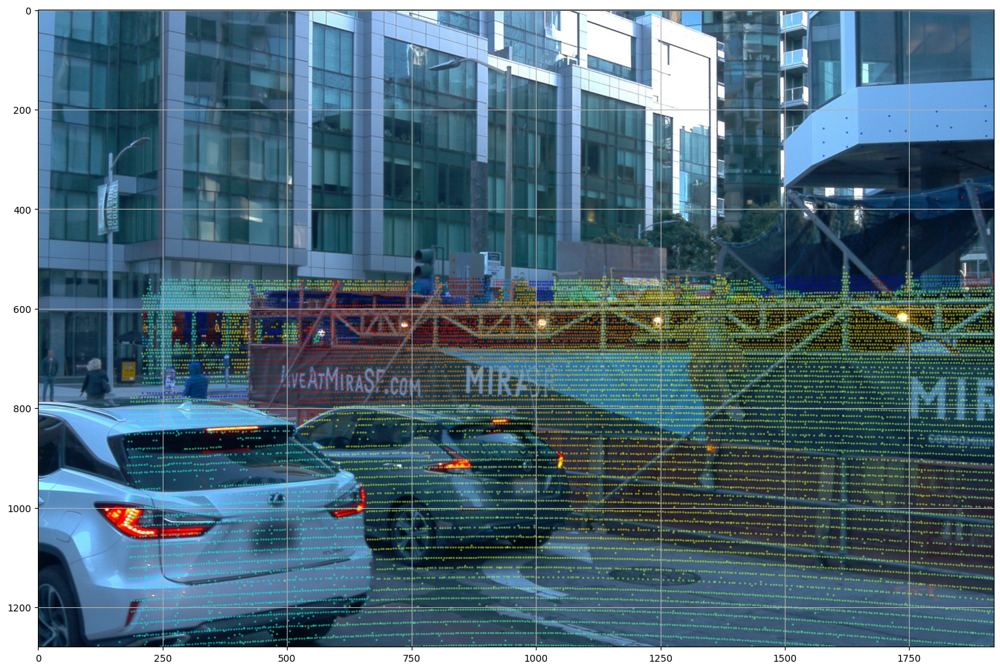

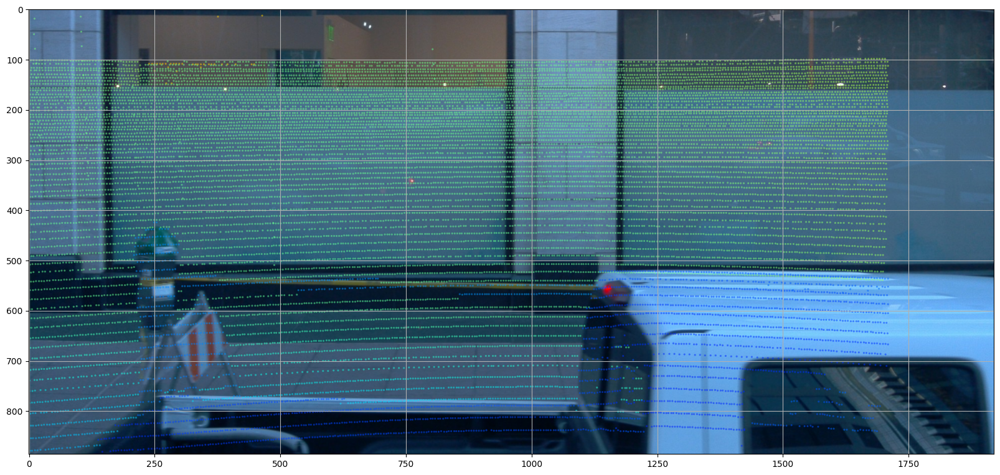

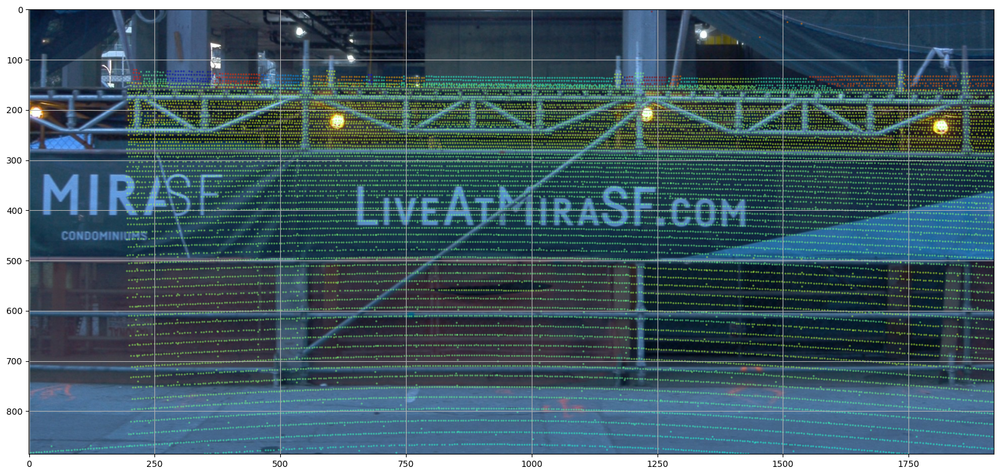

In [12]:
# Define the images variable outside the loop
images = sorted(frame.images, key=lambda i:i.name)

for img in range(len(images)):
   cp_points_all_concat = np.concatenate([cp_points_all, points_all], axis=-1)
   cp_points_all_concat_tensor = tf.constant(cp_points_all_concat)

   # The distance between lidar points and vehicle frame origin.
   points_all_tensor = tf.norm(points_all, axis=-1, keepdims=True)
   cp_points_all_tensor = tf.constant(cp_points_all, dtype=tf.int32)

   mask = tf.equal(cp_points_all_tensor[..., 0], images[img].name)

   cp_points_all_tensor = tf.cast(tf.gather_nd(
   cp_points_all_tensor, tf.where(mask)), dtype=tf.float32)
   points_all_tensor = tf.gather_nd(points_all_tensor, tf.where(mask))

   projected_points_all_from_raw_data = tf.concat(
       [cp_points_all_tensor[..., 1:3], points_all_tensor], axis=-1).numpy()

   plot_points_on_image(projected_points_all_from_raw_data,
                     images[img], rgba, point_size=5.0)


In [67]:
from waymo_open_dataset.protos import segmentation_metrics_pb2
from waymo_open_dataset.protos import segmentation_submission_pb2

dataset = tf.data.TFRecordDataset(tfrecord_file, compression_type='')
for data in dataset:
    frame = open_dataset.Frame()
    frame.ParseFromString(bytearray(data.numpy()))
    if frame.lasers[0].ri_return1.segmentation_label_compressed:
      break


print(frame.context.name)
print(frame.context.stats)


(range_images, camera_projections, segmentation_labels,
 range_image_top_pose) = frame_utils.parse_range_image_and_camera_projection(
    frame)


print(segmentation_labels[open_dataset.LaserName.TOP][0].shape.dims)

10023947602400723454_1120_000_1140_000
laser_object_counts {
  type: TYPE_VEHICLE
  count: 35
}
laser_object_counts {
  type: TYPE_PEDESTRIAN
  count: 27
}
laser_object_counts {
  type: TYPE_SIGN
  count: 22
}
time_of_day: "Day"
location: "location_sf"
weather: "sunny"
camera_object_counts {
  type: TYPE_VEHICLE
  count: 36
}
camera_object_counts {
  type: TYPE_PEDESTRIAN
  count: 30
}

[64, 2650, 2]


In [69]:
!pip install mayavi

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.1/7.1 MB 46.3 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 229.3/229.3 kB 23.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.9/268.9 kB 8.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 14.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.1/5.1 MB 28.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.5/1.5 MB 25.8 MB/s eta 0:00:00
  Using cached vtk-9.3.0-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (92.0 MB)
  Created wheel for mayavi: filename=mayavi-4.8.2-cp310-cp310-linux_x86_64.whl size=16760519 sha256=064ef5390022e7b12cd642a6803233e174eb57670545ad5a86c181c121e19697
  Stored in directory: /root/.cache/pip/wheels/60/52/8c/d16aeced951729965d3a787b59424bfc235372fafd1130c56e
Successfully built

## Unpacking and displaying bounding boxes

In [14]:
bounding_boxes = []

for camera_labels in frame.camera_labels:
    for label in camera_labels.labels:
        if label.HasField('box'):
            bounding_boxes.append({
                'center_x': label.box.center_x,
                'center_y': label.box.center_y,
                'center_z': label.box.center_z,
                'length': label.box.length,
                'width': label.box.width,
                'height': label.box.height,
                'heading': label.box.heading
            })

print(bounding_boxes)


[{'center_x': 900.01575, 'center_y': 665.69586, 'center_z': 0.0, 'length': 13.894980000000032, 'width': 22.737240000000043, 'height': 0.0, 'heading': 0.0}, {'center_x': 1303.60176, 'center_y': 697.9069499999999, 'center_z': 0.0, 'length': 29.053139999999985, 'width': 54.94832999999994, 'height': 0.0, 'heading': 0.0}, {'center_x': 1828.45305, 'center_y': 741.48666, 'center_z': 0.0, 'length': 67.58013000000005, 'width': 99.15962999999999, 'height': 0.0, 'heading': 0.0}, {'center_x': 951.17454, 'center_y': 658.74837, 'center_z': 0.0, 'length': 13.894980000000032, 'width': 15.789750000000026, 'height': 0.0, 'heading': 0.0}, {'center_x': 608.85276, 'center_y': 715.5914700000001, 'center_z': 0.0, 'length': 67.58012999999994, 'width': 99.15962999999999, 'height': 0.0, 'heading': 0.0}, {'center_x': 410.5335, 'center_y': 726.96009, 'center_z': 0.0, 'length': 51.79037999999997, 'width': 105.47553000000005, 'height': 0.0, 'heading': 0.0}, {'center_x': 1686.3285, 'center_y': 1027.6383624999999, 'c

## Drawing bounding boxes

Processing image 1/5 with 50 bounding boxes


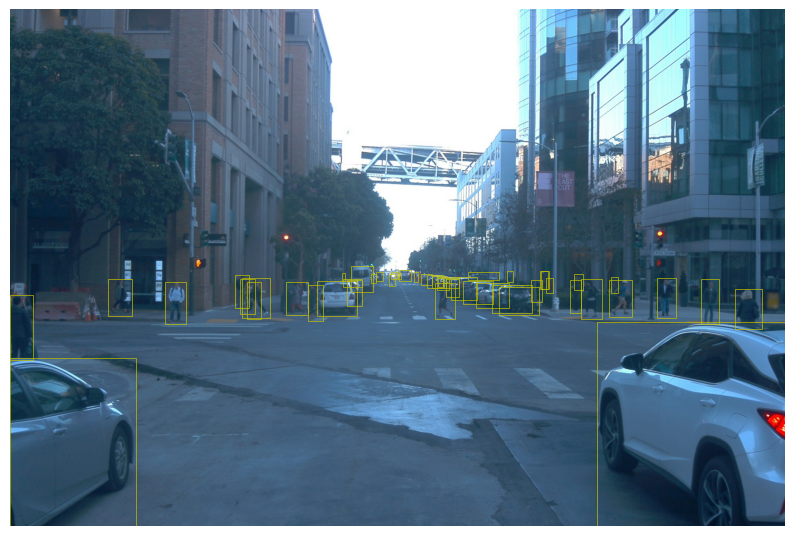

Processing image 2/5 with 11 bounding boxes


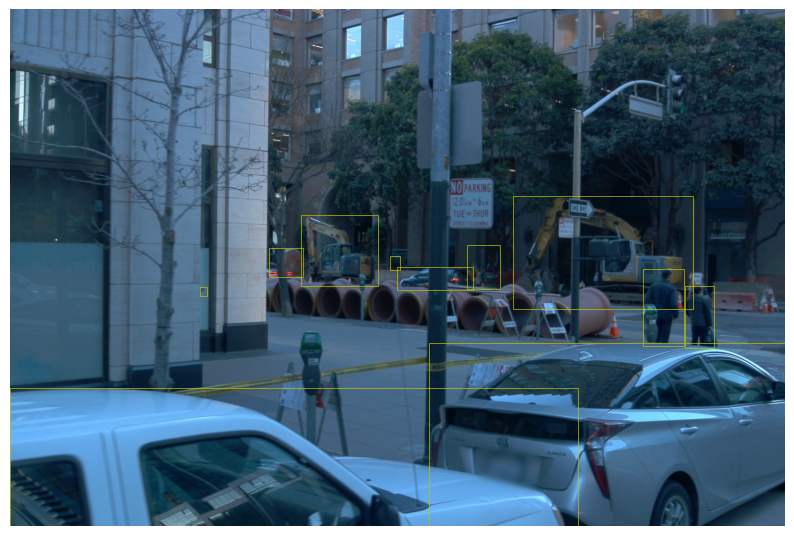

Processing image 3/5 with 1 bounding boxes


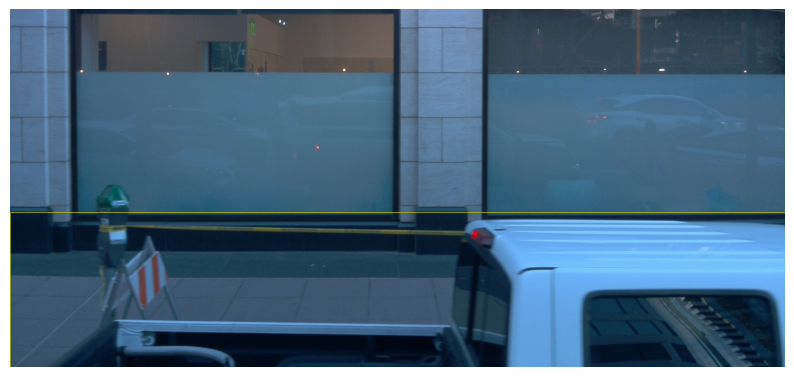

Processing image 4/5 with 5 bounding boxes


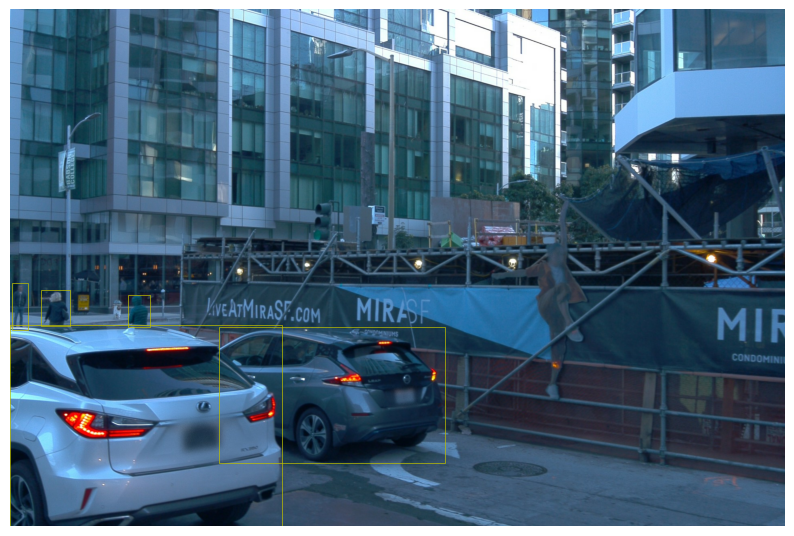

Processing image 5/5 with 0 bounding boxes


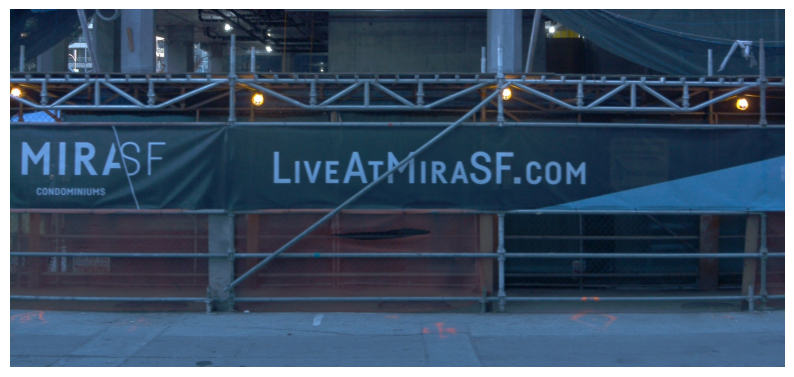

In [22]:
import matplotlib.pyplot as plt
from matplotlib.patches import Polygon
import tensorflow as tf
import numpy as np



def plot_bounding_boxes_on_image(image, bounding_boxes):
    """Plot bounding boxes on an image."""
    plt.figure(figsize=(10, 8))
    plt.imshow(image)
    ax = plt.gca()

    for box in bounding_boxes:
        center_x = box['center_x']
        center_y = box['center_y']
        length = box['length']
        width = box['width']
        heading = box['heading']

        # Calculate corner points of the bounding box
        corners = [
            [-length / 2, -width / 2],
            [length / 2, -width / 2],
            [length / 2, width / 2],
            [-length / 2, width / 2]
        ]

        # Apply rotation to corner points
        rotated_corners = []
        for corner in corners:
            x = corner[0] * np.cos(heading) - corner[1] * np.sin(heading) + center_x
            y = corner[0] * np.sin(heading) + corner[1] * np.cos(heading) + center_y
            rotated_corners.append([x, y])

        # Plot the bounding box
        polygon = Polygon(rotated_corners, closed=True, edgecolor='y', facecolor='none', linewidth=0.5)
        ax.add_patch(polygon)

    plt.axis('off')
    plt.show()

# Organize bounding boxes by image name
bounding_boxes_per_image = {}
for camera_labels in frame.camera_labels:
    image_name = camera_labels.name
    if image_name not in bounding_boxes_per_image:
        bounding_boxes_per_image[image_name] = []
    for label in camera_labels.labels:
        if label.HasField('box'):
            bounding_boxes_per_image[image_name].append({
                'center_x': label.box.center_x,
                'center_y': label.box.center_y,
                'center_z': label.box.center_z,
                'length': label.box.length,
                'width': label.box.width,
                'height': label.box.height,
                'heading': label.box.heading
            })

# Assuming `frame` is the frame object containing the images
for idx, image in enumerate(frame.images):
    if idx >= 5:  # Limit to 5 images
        break
    image_name = image.name
    if image_name in bounding_boxes_per_image:
        print(f"Processing image {idx+1}/{len(frame.images)} with {len(bounding_boxes_per_image[image_name])} bounding boxes")
        plot_bounding_boxes_on_image(tf.image.decode_jpeg(image.image).numpy(), bounding_boxes_per_image[image_name])
    else:
        print(f"Processing image {idx+1}/{len(frame.images)} with no bounding boxes")
        plot_bounding_boxes_on_image(tf.image.decode_jpeg(image.image).numpy(), [])
